In [1]:
from itertools import combinations
from google.cloud import bigquery
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import os
import pandas as pd

os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = '../../gcp_credentials.json'
client = bigquery.Client()

# Get relevant projects

In [110]:
op_collections = ['op-rpgf1', 'op-rpgf2', 'op-rpgf3', 'op-govgrants']
arb_collections = ['arb-stip-1', 'arbitrum-crypto-ecosystems', 'arb-onchain']

query = """
    SELECT *
    FROM `opensource-observer.oso.projects_by_collection`
    WHERE collection_slug IN (
        'op-rpgf1', 'op-rpgf2', 'op-rpgf3', 'op-govgrants',
        'arb-stip-1', 'arbitrum-crypto-ecosystems', 'arb-onchain'
    )
    AND project_slug != 'protocol-guild'
"""
result = client.query(query)
projects_by_collection = result.to_dataframe()

In [111]:
projects_by_collection

,project_id,project_slug,project_name,collection_id,collection_slug,collection_name
0,FxYVsd-Hjo3eAFYxsU1-j2fCGWM-nDKjK_llEScYOyM=,equilibria-xyz,Equilibria (Perennial Finance),7K0msv6H9FjIQ9KuZoqqLo__pyg1g_EJfnMi_-yx2lY=,arb-stip-1,Arbitrum STIP Round 1
1,G7_Lm4_DUi_oTAv1xJclMQXwI22gW1xIpLMs9ni_oac=,abracadabra,Abracadabra,7K0msv6H9FjIQ9KuZoqqLo__pyg1g_EJfnMi_-yx2lY=,arb-stip-1,Arbitrum STIP Round 1
2,quFqv8HEYfaDQgW-JDk8tBLUQKFO3PhuNhN8dGssZ70=,gmx-io,GMX,7K0msv6H9FjIQ9KuZoqqLo__pyg1g_EJfnMi_-yx2lY=,arb-stip-1,Arbitrum STIP Round 1
3,W1Y0YdIHScazGk_CfHebBjnKTvksjvzTHI2Spt8JrBM=,goodentry-io,GoodEntry,7K0msv6H9FjIQ9KuZoqqLo__pyg1g_EJfnMi_-yx2lY=,arb-stip-1,Arbitrum STIP Round 1
4,jKtrX2PruKd0nr2nElWzSsxXTihN1taPQCYi-BX5J0Q=,ramsesexchange,Ramses,7K0msv6H9FjIQ9KuZoqqLo__pyg1g_EJfnMi_-yx2lY=,arb-stip-1,Arbitrum STIP Round 1
...,...,...,...,...,...,...
1155,S5H5r4VuO_VZYeGIAHG8JZ-a319Hf6q9SiVFs8zwrMA=,taho-wallet,Taho,ywQLf8PL1_AZd_Bw4pA5SUayEKtiVcI4-dOi-atOmZA=,op-govgrants,OP GovGrants
1156,D1kTRxhL5jyrUMM89CpODFq7N0OFAiVX04m_1FUqktk=,blocknative,Blocknative,ywQLf8PL1_AZd_Bw4pA5SUayEKtiVcI4-dOi-atOmZA=,op-govgrants,OP GovGrants
1157,osL3B-y8yn0ALvvF90E-K8sPXgenbqc3PCpeCC67MHE=,metagov,The Metagovernance Project,ywQLf8PL1_AZd_Bw4pA5SUayEKtiVcI4-dOi-atOmZA=,op-govgrants,OP GovGrants
1158,uCFZ6RPPJUucwIjacMAGKz7yZpZqh3Kt2njxZoPTxQ4=,spearbit-portfolio,Spearbit Labs,ywQLf8PL1_AZd_Bw4pA5SUayEKtiVcI4-dOi-atOmZA=,op-govgrants,OP GovGrants


In [112]:
op_project_ids = list(
    projects_by_collection[
        projects_by_collection['collection_slug']
        .isin(op_collections)
    ]['project_id']
    .unique()
)
print("OP:", len(op_project_ids))

arb_project_ids = list(
    projects_by_collection[
        projects_by_collection['collection_slug']
        .isin(arb_collections)
    ]['project_id']
    .unique()
)
print("ARB:", len(arb_project_ids))

OP: 465
ARB: 349


In [113]:
project_ids = list(set(op_project_ids).union(set(arb_project_ids)))
project_ids_str = "','".join(project_ids)
print(len(project_ids))

728


In [114]:
PROJECT_NAMES = (
    projects_by_collection[['project_id', 'project_name']]
    .drop_duplicates()
    .set_index('project_id')
    ['project_name']
    .to_dict()
)

# Get developer activity

In [115]:
query = f"""
    SELECT *
    FROM `opensource-observer.oso.active_devs_monthly_to_project`
    WHERE project_id IN ('{project_ids_str}')
      AND user_segment_type != 'OTHER_CONTRIBUTOR'
"""
result = client.query(query)
devs = result.to_dataframe()

In [116]:
devs.head()

,project_id,from_id,repository_source,bucket_month,amount,user_segment_type
0,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,7GFvcLqhKyfG3eJG3Fb9fsKZxgPoNVToo5gOalCYMXY=,GITHUB,2023-05-01 00:00:00+00:00,1,PART_TIME_DEV
1,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,7GFvcLqhKyfG3eJG3Fb9fsKZxgPoNVToo5gOalCYMXY=,GITHUB,2022-05-01 00:00:00+00:00,1,PART_TIME_DEV
2,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,7GFvcLqhKyfG3eJG3Fb9fsKZxgPoNVToo5gOalCYMXY=,GITHUB,2022-08-01 00:00:00+00:00,1,PART_TIME_DEV
3,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,7GFvcLqhKyfG3eJG3Fb9fsKZxgPoNVToo5gOalCYMXY=,GITHUB,2022-10-01 00:00:00+00:00,1,PART_TIME_DEV
4,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,7GFvcLqhKyfG3eJG3Fb9fsKZxgPoNVToo5gOalCYMXY=,GITHUB,2022-12-01 00:00:00+00:00,1,PART_TIME_DEV


In [170]:
devs[
    (devs['project_id'].isin(op_project_ids))
    & (devs['bucket_month'] == '2024-03-01 00:00:00+00:00')
]['from_id'].nunique()

1189

In [171]:
devs[
    (devs['project_id'].isin(arb_project_ids))
    & (devs['bucket_month'] == '2024-03-01 00:00:00+00:00')
]['from_id'].nunique()

1104

# Get user activity

In [117]:
query = f"""
    SELECT *
    FROM `opensource-observer.oso.address_rfm_segments_by_project`
    WHERE project_id IN ('{project_ids_str}')
    AND rfm_frequency > 2 and rfm_recency > 2
"""
result = client.query(query)
users = result.to_dataframe()

In [118]:
users.head()

,from_id,network,project_id,rfm_recency,rfm_frequency,rfm_ecosystem,user_segment
0,k5k5amsp7HZ0Y7EUMNOsnvkUqGfGZtFBYOh0IP47vJ0=,ARBITRUM,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,3,4,4,At risk
1,k0lZNYksjKVYmAwSuadoHEE-3Fi9B0GTQB1QHfPh8p0=,ARBITRUM,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,3,4,3,At risk
2,0TfbAgAWzIkrkfU9pvHKKrDMMlkUYccMjSgsBySbAPM=,ARBITRUM,-A5N7DYgI4bDZZQaF_4SPw_qx6cv1BbfcoxJ7rZxig8=,3,5,4,At risk
3,OiHl-5OnJrorRrcDsDYodRObG54_AHLm0zkAadWZHeU=,OPTIMISM,6fLsB5BZHfI1tPdWILgHSAWF6hcYpycAlU9B8PQxziU=,3,4,4,At risk
4,QdQfHnSIWLpSCuoXP7JRzzLygaVjwKlPCxp7LCEv1rA=,OPTIMISM,7UvoYLwQcGamsUW0EDD7aipxdaT5to2z-FJ1P6kh-4k=,3,5,1,At risk


# Create network graphs

In [153]:
def make_graph(dataframe, list_of_project_ids, min_degree=3, min_edges=2):
    
    dff = dataframe[dataframe['project_id'].isin(list_of_project_ids)].copy()
    dff['project_name'] = dff['project_id'].map(PROJECT_NAMES)
    
    nodes = list(dff['project_name'].unique())
    edges = []
    
    contributions = dff.groupby('from_id')['project_id'].unique()
    for _,c in contributions.items():
        if len(c) < min_edges:
            continue
        edges.extend(combinations(c,2))
        
    G = nx.DiGraph()
    G.add_nodes_from(nodes)
    G.add_edges_from(edges)
    G = nx.k_core(G, min_degree)

    return G


def visualize_graph(graph, node_colors, node_scaler=3):
    
    degrees = dict(graph.degree)
    pos = nx.kamada_kawai_layout(graph)

    fig, ax = plt.subplots(figsize=(12,12), dpi=300)
    nx.draw(graph, pos, 
        node_size=[degrees[d]*node_scaler for d in degrees], 
        node_color=node_colors,
        with_labels=False, 
        arrows=False, 
        width=.1, 
        alpha=.5
    )

## Contributor networks

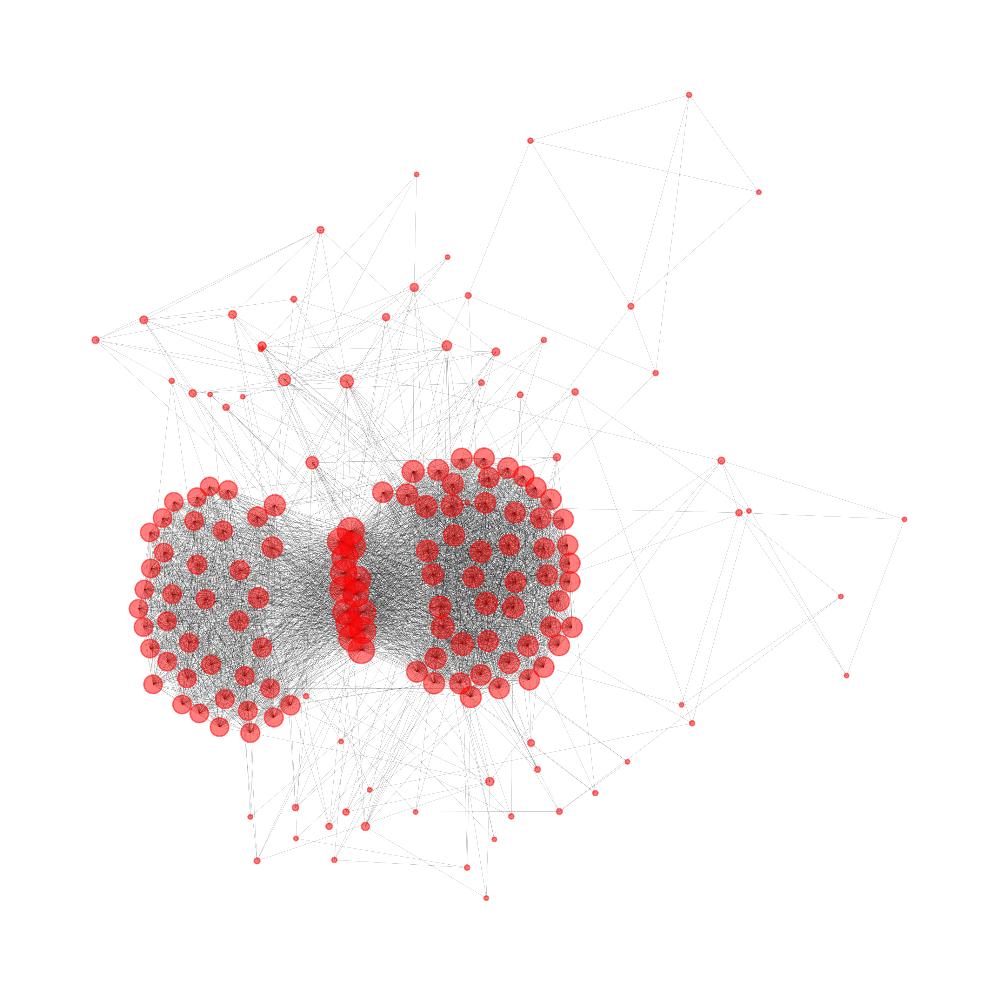

In [154]:
# OP
visualize_graph(make_graph(devs, op_project_ids), 'red')

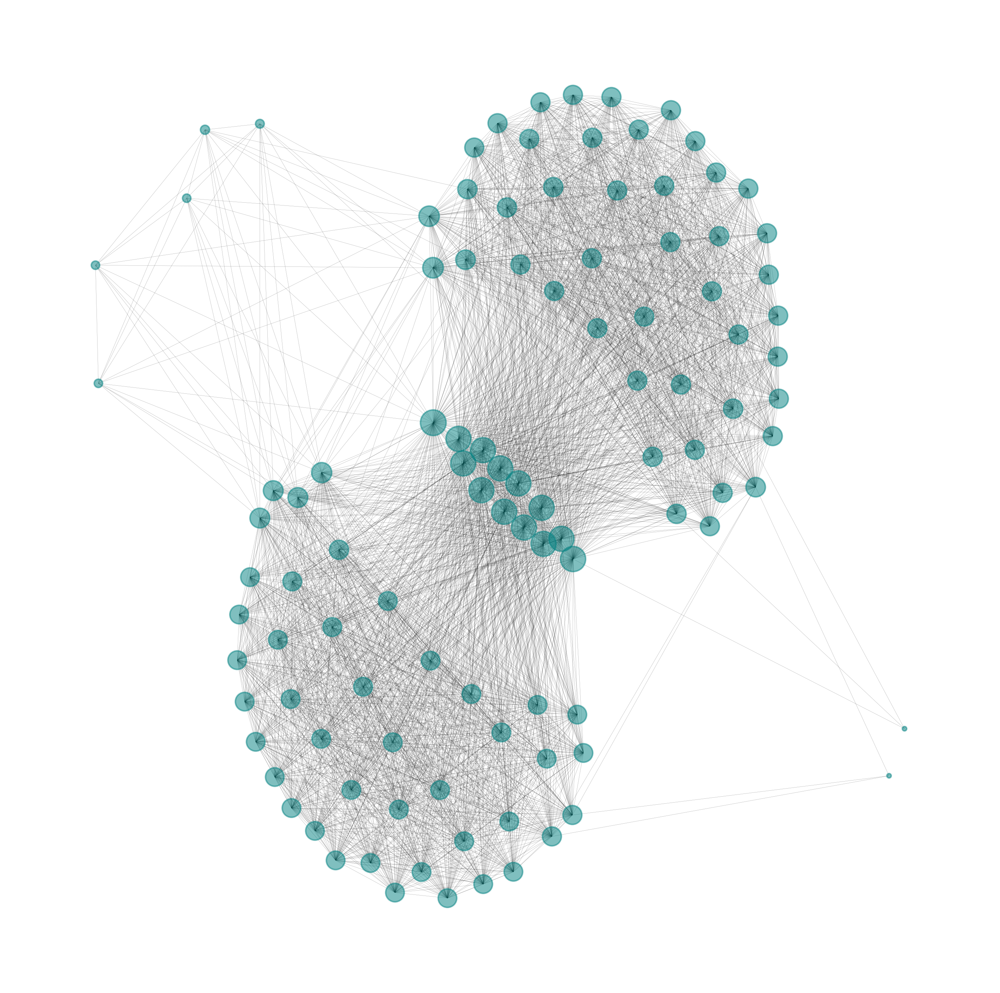

In [155]:
# ARB
visualize_graph(make_graph(devs, arb_project_ids), 'teal')

## User networks

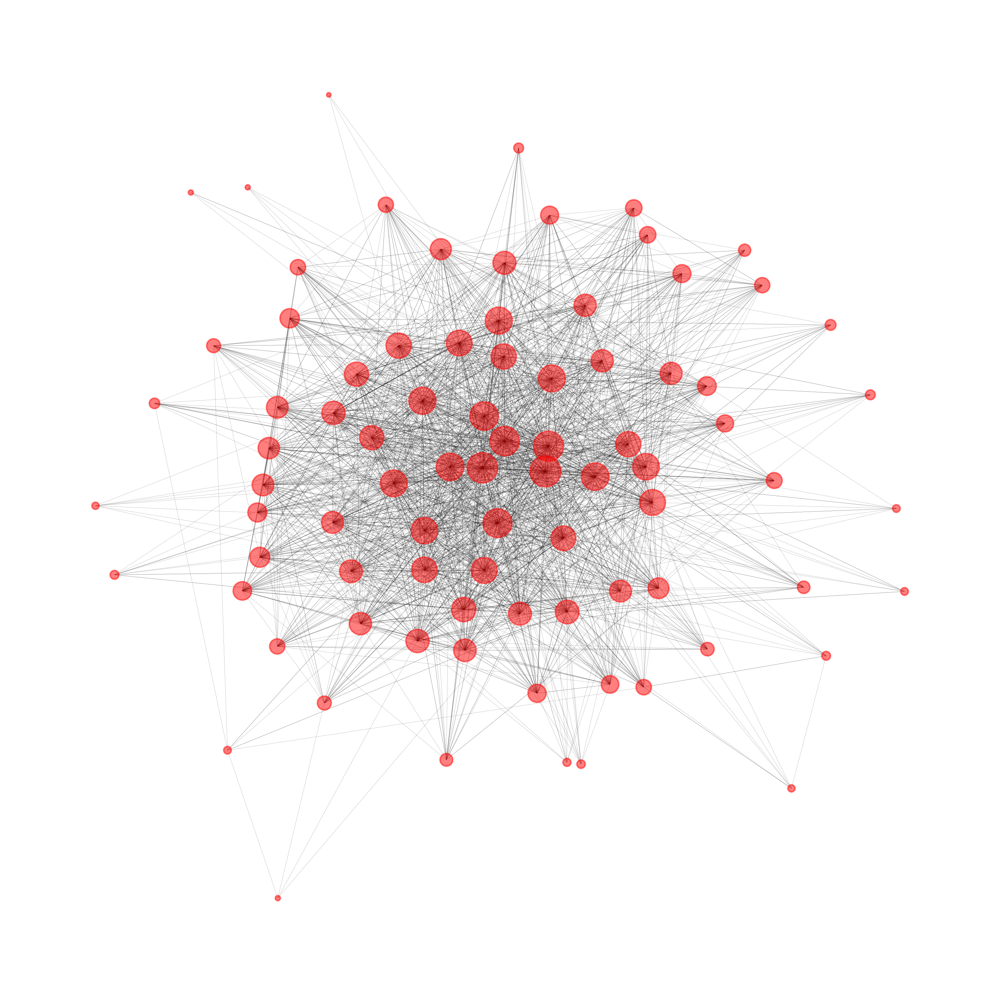

In [156]:
visualize_graph(make_graph(users, op_project_ids), 'red')

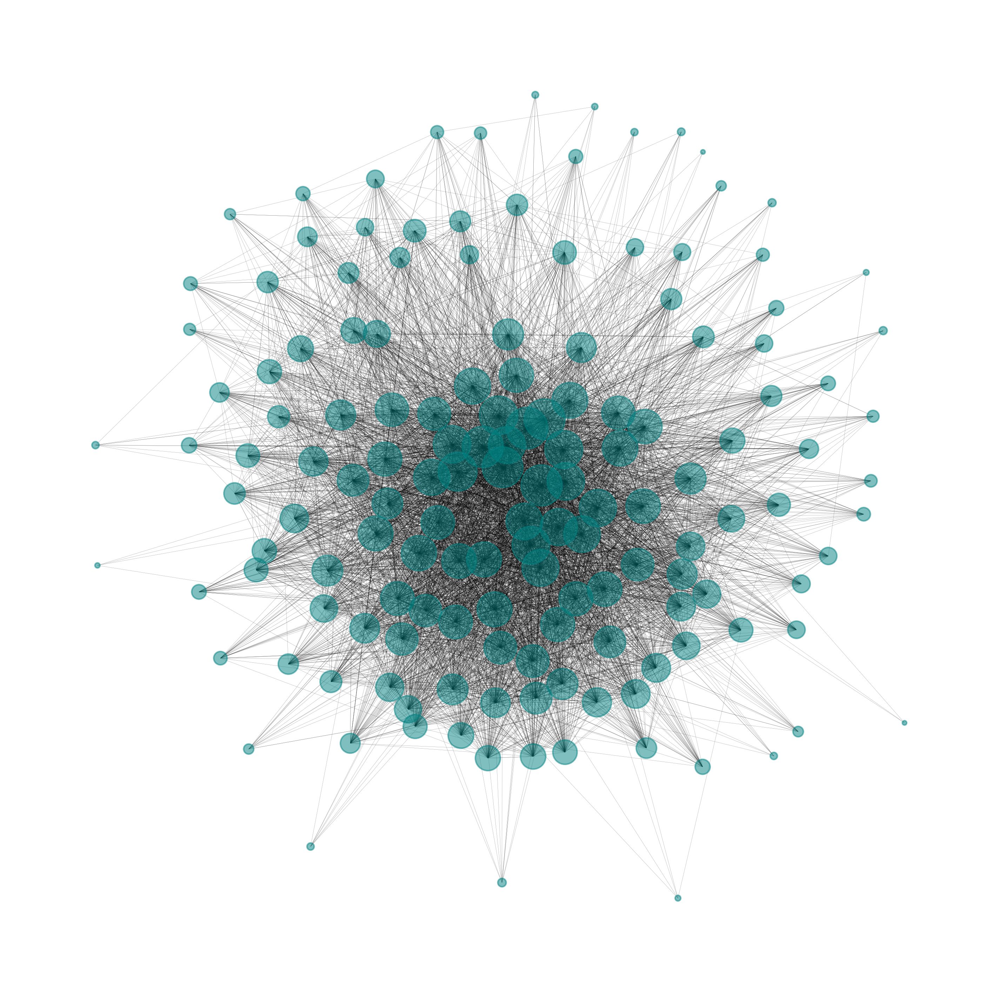

In [157]:
visualize_graph(make_graph(users, arb_project_ids), 'teal')

## Combined networks

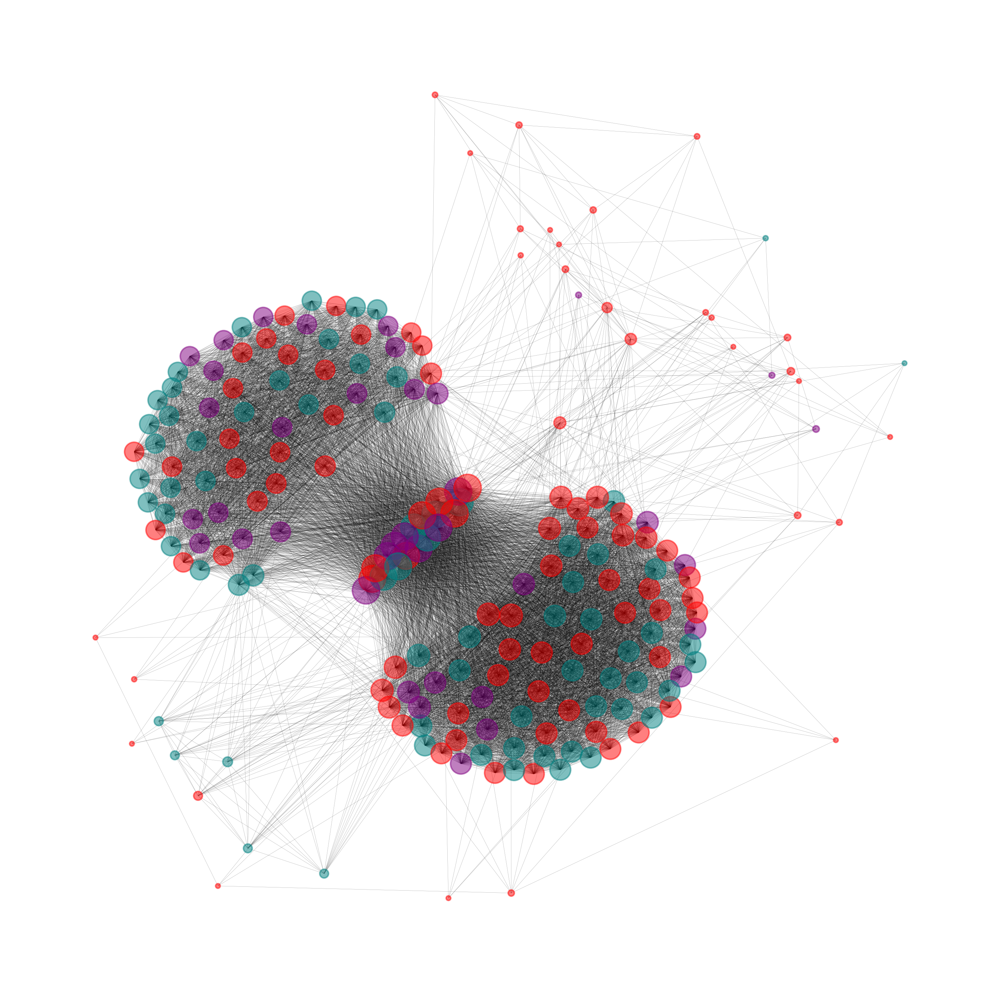

In [164]:
devs_graph = make_graph(devs, project_ids, min_degree=5)

node_colors = []
for p in devs_graph.nodes:
    if p in op_project_ids:
        if p in arb_project_ids:
            node_colors.append('purple')
        else:
            node_colors.append('red')
    else:
        node_colors.append('teal')        
        
visualize_graph(devs_graph, node_colors, node_scaler=2)

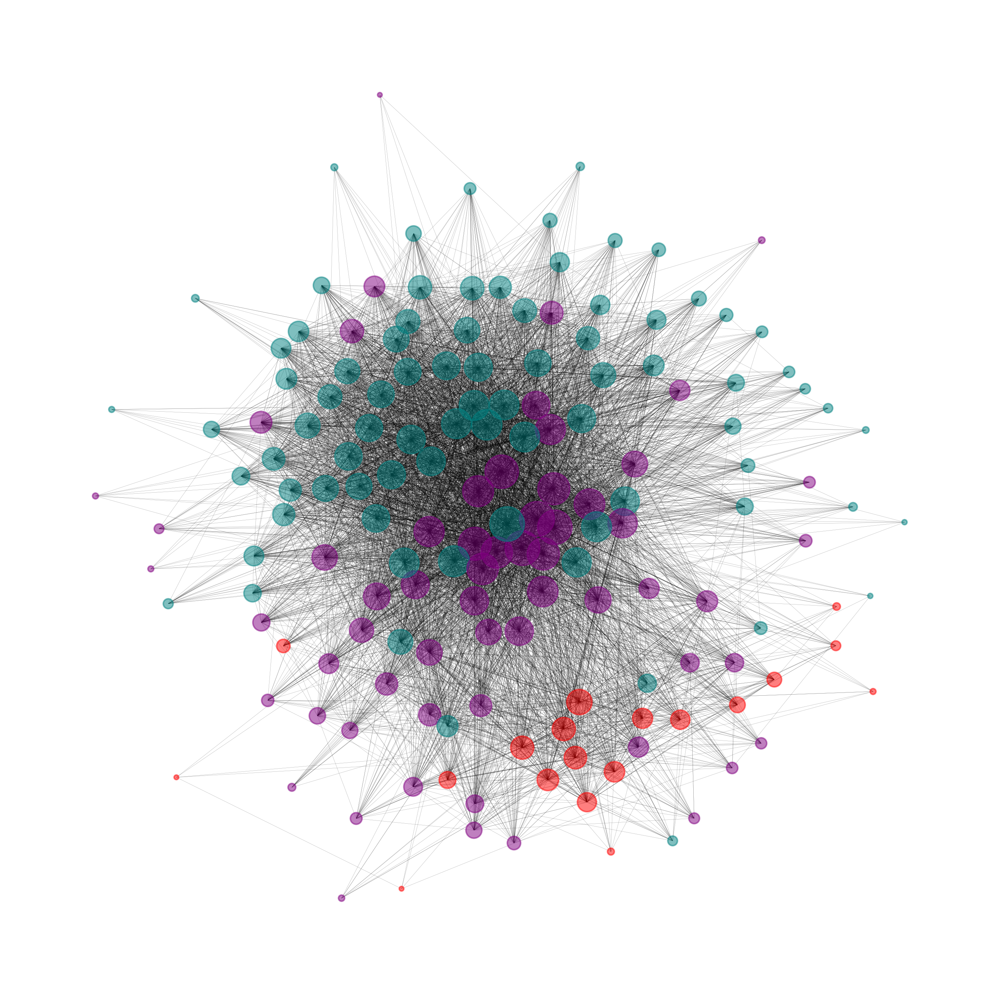

In [166]:
users_graph = make_graph(users, project_ids, min_degree=5, min_edges=5)

node_colors = []
for p in users_graph.nodes:
    if p in op_project_ids:
        if p in arb_project_ids:
            node_colors.append('purple')
        else:
            node_colors.append('red')
    else:
        node_colors.append('teal')        
        
visualize_graph(users_graph, node_colors, node_scaler=2)